In [1]:
# USER-SPECIFIC: The folder paths holding simulation outputs and observations

if not 'Simulation_output_folders' in locals():  
    Simulation_output_folders = [] 

if not 'Simulated_stations_Excel_folders' in locals():
    Simulated_stations_Excel_folders = [r'..\Examples\example_Compare_at_stations_with Excel\TOPWATCH outputs',
                                       r'..\Examples\example_Compare_at_stations_with Excel\PCRGLOBWB outputs',
                                       ]

if not 'titles' in locals():
    titles = ['observations', 'TOPWATCH', 'PCRGLOBWB']
    # titles = ['observations']+['dataset '+str(num) for num in range(len(Simulation_output_folders)+len(Simulated_stations_Excel_folders))]
    
if not 'output_variable' in locals():
    output_netcdf = 'discharge_daily'
    output_variable = 'discharge'
    
# observations_folder holds one Excel (observation_locations.xlsx) with names and locations, and
    # a folder (Observations) with an Excel file for each station. The Excel files are named after the station names.
    #
    # observations_locations.xlsx has three columns: Station, Latitude, Longitude
    #
    # observations_folder
    # ↵ observations_locations.xlsx
    # ↵ Observations
    #   ↵ StationName1.xlsx #first two rows not read
    #   ↵ StationName2.xlsx #first two rows not read
    #   ↵ ...

if not 'template' in locals():
     template = "plotly_dark"
     
if not 'observations_folder' in locals():      
    observations_folder = r'..\Examples\example_Compare_at_stations_with Excel\Zambezi_observations'

if not 'Excel_two_first_rows_not_read' in locals(): 
    Excel_two_first_rows_not_read = False

if not 'write_excel_obs_sims' in locals():
    write_excel_obs_sims = False
    

In [2]:
from netCDF4 import Dataset, num2date
import plotly.graph_objects as go
import numpy as np
import pandas as pd
import os

In [3]:
observed_discharge_folder = os.path.join(observations_folder, 'Observations')
Simulated_output_paths = [folder + '/' + output_netcdf + '.nc' for folder in Simulation_output_folders]

In [4]:
def geo_idx(dd, dd_array):
    """
     search for nearest decimal degree in an array of decimal degrees and return the index.
     np.argmin returns the indices of minium value along an axis.
     so subtract dd from all values in dd_array, take absolute value and find index of minium.
    """
    
    geo_idx = (np.abs(dd_array - dd)).argmin()
    
    return geo_idx

## Simulated discharge

In [5]:

from functions import read_observations_excel, read_simulations_excel
Stations_namesLocations, DATES_observed, FLOWS_observed = read_observations_excel(observations_folder=observations_folder)

NC_SIMULATED = []
LATS = []
LONS = []
DATES_SIMULATED = []
OUTPUTS_SIMULATED = []

print('Loading simulations')

latlon_coord = True
for simulation in Simulated_output_paths:
    
    nc_simulated = Dataset(simulation, 'r')
    try:
        lats = nc_simulated.variables['lat'][:]
        lons = nc_simulated.variables['lon'][:]
    except:
        latlon_coord = False
        lats = nc_simulated.variables['x'][:]
        lons = nc_simulated.variables['y'][:]
        
    Dates_simulated = num2date(nc_simulated.variables['time'][:], units=nc_simulated.variables['time'].units, 
                               only_use_cftime_datetimes=False, only_use_python_datetimes=True)
    
    Dates_simulated = pd.to_datetime(Dates_simulated).date

    Outputs_simulated = []
    
    NC_SIMULATED.append(nc_simulated)
    LATS.append(lats)
    LONS.append(lons)
    DATES_SIMULATED.append(Dates_simulated)
    OUTPUTS_SIMULATED.append(Outputs_simulated)

for discharge_location in Stations_namesLocations:
    in_lat = discharge_location[1]
    in_lon = discharge_location[2]
    
    for sim in range(len(Simulated_output_paths)):
        lats = LATS[sim]
        lons = LONS[sim]
    
        lat_idx = geo_idx(in_lat, lats)
        lon_idx = geo_idx(in_lon, lons)
        #print(lats[lat_idx], lons[lon_idx])

        if latlon_coord:
            OUTPUTS_SIMULATED[sim].append(NC_SIMULATED[sim].variables[output_variable][:, lat_idx, lon_idx])
            
        else:
            OUTPUTS_SIMULATED[sim].append(NC_SIMULATED[sim].variables[output_variable][:, lon_idx, lat_idx])

for folder in Simulated_stations_Excel_folders:

    DATES_simulated, FLOWS_simulated = read_simulations_excel(folder, Stations_namesLocations)

    DATES_SIMULATED.append(DATES_simulated[0])
    OUTPUTS_SIMULATED.append(FLOWS_simulated)

Loading observations
Loading simulations
Loading simulations from Excel
Loading simulations from Excel


## Visualisation 

In [6]:
RMSD_allStn, NRMSD_allStn, KGE_allStn, bias_allStn, corr_allStn, NS_allStn = [],[],[],[],[],[]

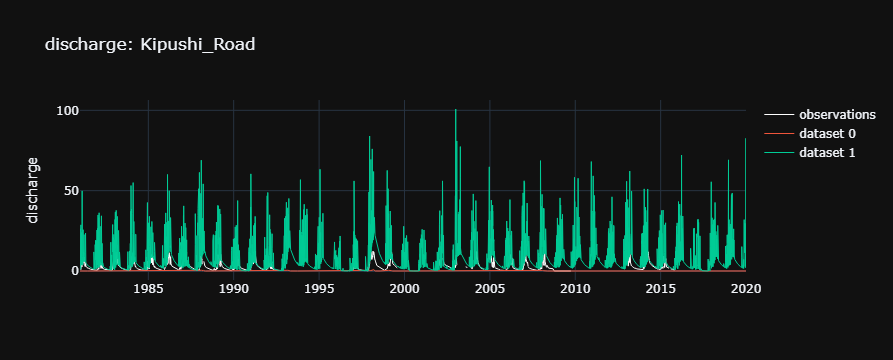

Kipushi_Road


KGE,NS,Bias,Corr,RMSD,NRMSD
-0.98,-0.93,-98.84,0.62,3.61,1.40
-0.94,-11.33,183.00,0.37,9.13,3.52


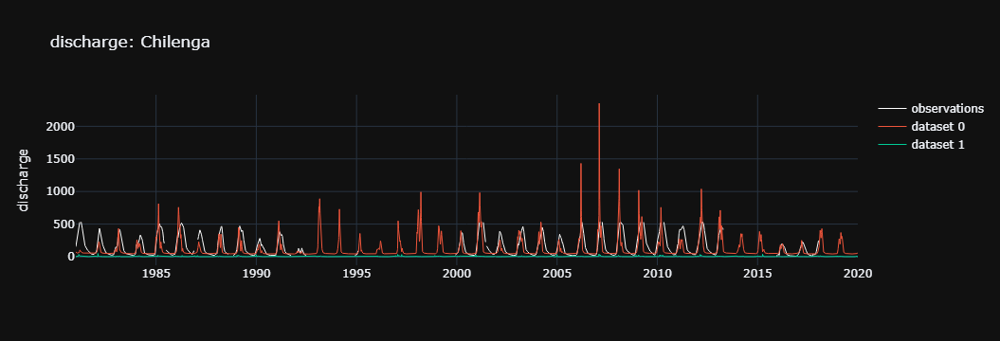

Chilenga


KGE,NS,Bias,Corr,RMSD,NRMSD
0.33,0.07,-31.93,0.57,141.22,0.95
-0.35,-1.09,-98.68,0.40,212.88,1.36


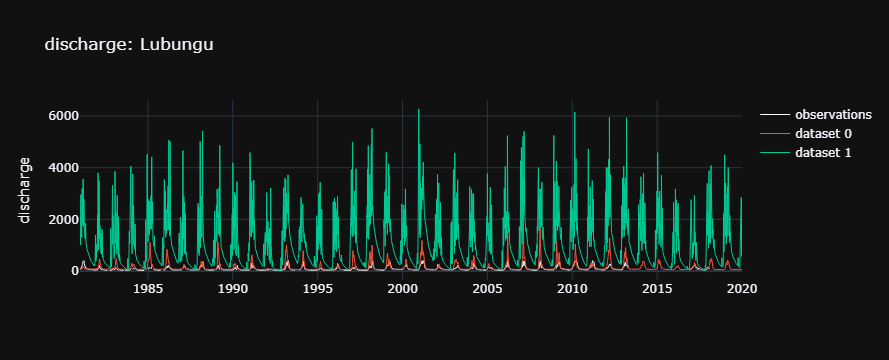

Lubungu


KGE,NS,Bias,Corr,RMSD,NRMSD
0.10,-3.37,70.19,0.72,138.38,1.83
-11.18,-359.57,1217.22,0.61,1257.32,16.61


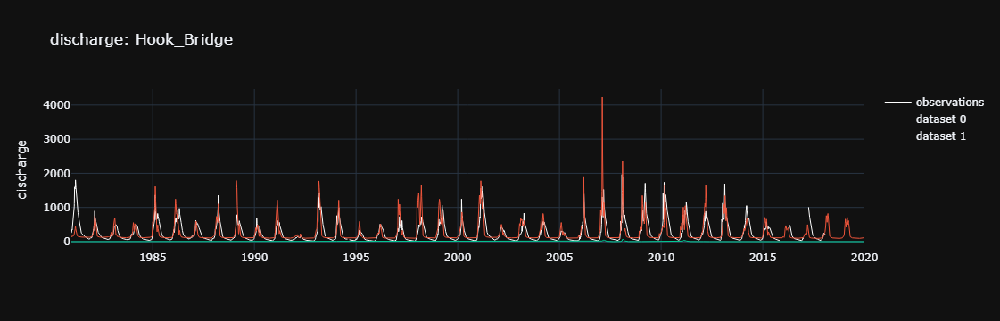

Hook_Bridge


KGE,NS,Bias,Corr,RMSD,NRMSD
0.69,0.37,-1.57,0.69,221.98,0.91
-1.28,-0.88,-99.41,0.49,398.22,1.44


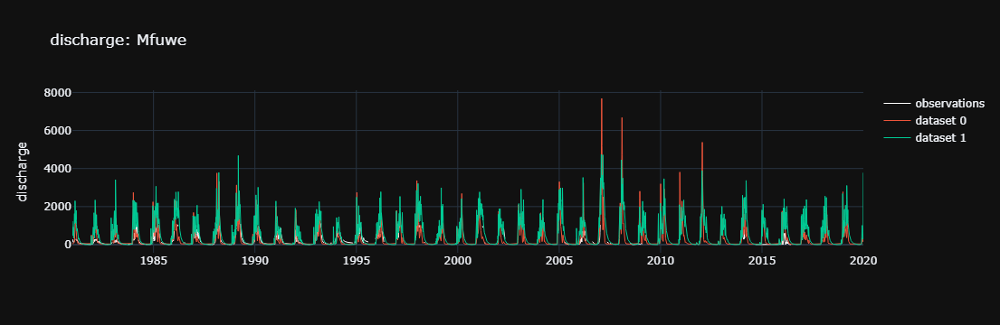

Mfuwe


KGE,NS,Bias,Corr,RMSD,NRMSD
0.42,-0.76,23.70,0.54,289.31,1.89
-0.39,-2.70,135.76,0.71,419.62,2.74


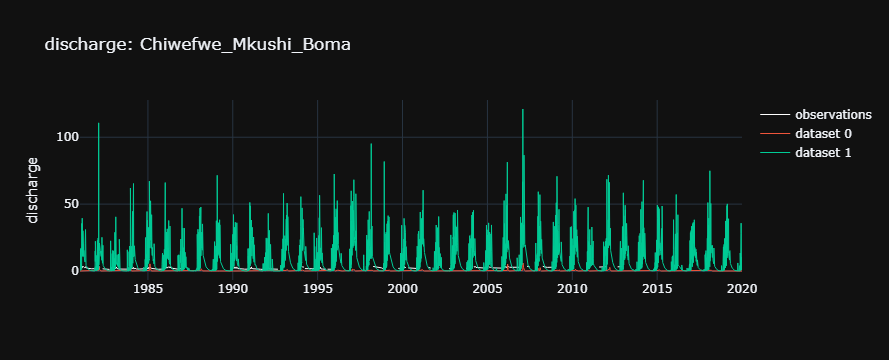

Chiwefwe_Mkushi_Boma


KGE,NS,Bias,Corr,RMSD,NRMSD
-26.40,-10.51,-99.14,0.09,2.06,1.04
-3.72,-181.41,137.55,0.27,8.17,4.12


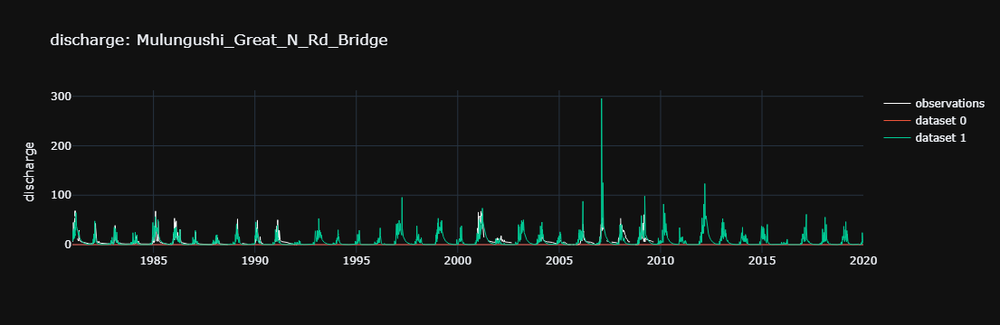

Mulungushi_Great_N_Rd_Bridge


KGE,NS,Bias,Corr,RMSD,NRMSD
-4.32,-0.49,-99.98,0.35,11.60,1.74
0.54,0.25,-15.67,0.66,8.22,1.23


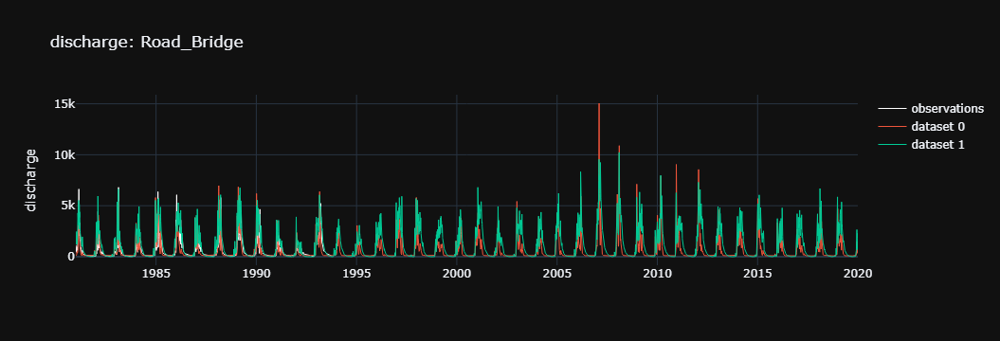

Road_Bridge


KGE,NS,Bias,Corr,RMSD,NRMSD
0.73,0.53,-6.56,0.79,610.87,1.09
0.33,0.20,64.45,0.85,800.08,1.43


In [7]:
import hydroStats as hydroStats
for i in range(len(Stations_namesLocations)):

    fig = go.Figure()
    
    fig.add_trace(go.Scatter(y=FLOWS_observed[i],
                             x=DATES_observed[i],
                    mode='lines',
                    name=titles[0],
                            opacity=1, 
                            line=dict(width=1, color='#FFFFFF'))) #,
                            #marker = dict(size=2)))
    
    if write_excel_obs_sims:
        Excel_timeseries_observations = pd.DataFrame({'Observed dates':DATES_observed[i], 'Observed flows':FLOWS_observed[i]})
        with pd.ExcelWriter(Stations_namesLocations[i][0]+'.xlsx') as writer:  
            Excel_timeseries_observations.to_excel(writer, sheet_name='Observations', index=False)
                                                                             
    RMSD, NRMSD, KGE, bias, corr, NS = [],[],[],[],[],[]

    Excel_timeseries_simulations = pd.DataFrame({'Simulated dates':DATES_SIMULATED[0]})

    for sim in range(len(Simulated_output_paths)+len(Simulated_stations_Excel_folders)):

        fig.add_trace(go.Scatter(y=OUTPUTS_SIMULATED[sim][i],
                                 x=DATES_SIMULATED[sim],
                        mode='lines',
                        name=titles[sim+1],
                                line=dict(width=1))) #color='#ff7f0e',

        Excel_timeseries_simulations.insert(sim+1, titles[sim+1], OUTPUTS_SIMULATED[sim][i])

        FLOWS_simulated = OUTPUTS_SIMULATED[sim] 
        Dates_simulated = DATES_SIMULATED[sim]

        max_simulated = max(FLOWS_simulated[i])

        start = 0
        for d in range(len(DATES_observed[i])):
            # Find the match of the first observation to the first simulated day
            if DATES_observed[i][d] == Dates_simulated[0]:
                start = d
                break
        startSim = 0
        if start == 0:
            #Simulation begins before observations
            #Find first simulation date
            for d in range(len(Dates_simulated)):
                if Dates_simulated[d] == DATES_observed[i][0]:
                    startSim = d
                    break

        if startSim == 0 and start ==0 and Dates_simulated[0] != DATES_observed[i][0]: #DATES_observed[i][-1]
            #print('There is no overlap of simulation and observation.')
            KGE.append('-')
            bias.append('-')
            corr.append('-')
            NS.append('-')
            RMSD.append('-')
            NRMSD.append('-')
            
        else:
            oval=[]
            o = FLOWS_observed[i][start:]
            s = []

            end = 0
            for d in range(len(o)):
                if not np.isnan(o[d]): 
                    try:
                        if FLOWS_simulated[i][d+startSim] > 0:
                            s.append(FLOWS_simulated[i][d+startSim])
                            oval.append(o[d])
                    except: 
                        end = d
                        break  

            sval = np.asarray(s)

            MSE = 0
            for d in range(len(oval)):
                MSE += (oval[d]-sval[d])**2

            if len(oval) > 0:
                rmsd = (MSE/len(oval)) ** .5
            
                RMSD.append("{:.2f}".format(rmsd))
                NRMSD.append("{:.2f}".format(rmsd/np.mean(oval)))
                KGE.append("{0:.2f}".format(hydroStats.KGE(s=sval, o=oval, warmup=0)))
                bias.append("{0:.2f}".format(hydroStats.pc_bias2(s=sval, o=oval, warmup=0)))
                corr.append("{0:.2f}".format(hydroStats.correlation(s=sval, o=oval, warmup=0)))
                NS.append("{0:.2f}".format(hydroStats.NS(s=sval, o=oval, warmup=0)))
            else:
                RMSD.append('-')
                NRMSD.append('-')
                KGE.append('-')
                bias.append('-')
                corr.append('-')
                NS.append('-')
                
    if write_excel_obs_sims:
        with pd.ExcelWriter(Stations_namesLocations[i][0]+'.xlsx',
                    mode='a', engine="openpyxl") as writer:  
            Excel_timeseries_simulations.to_excel(writer, sheet_name='Simulations', index=False)

    data_WB = {'KGE': KGE, 'NS':NS, 'Bias':bias, 'Corr':corr, 'RMSD':RMSD, 'NRMSD':NRMSD}
    df = pd.DataFrame(data_WB)
    df=df.style.set_table_styles([{'selector': 'th', 'props': [('font-size', '12pt')]}]).set_properties(**{"font-size": "12pt"}).hide(axis='index') 
    
    fig.update_layout(title=output_variable +': '+ str(Stations_namesLocations[i][0]),
                   yaxis_title=output_variable, template=template)

    fig.show()
    
    print(Stations_namesLocations[i][0])

    display(df)
    
    RMSD_allStn.append(RMSD) 
    NRMSD_allStn.append(NRMSD)
    KGE_allStn.append(KGE)
    bias_allStn.append(bias)
    corr_allStn.append(corr)
    NS_allStn.append(NS)



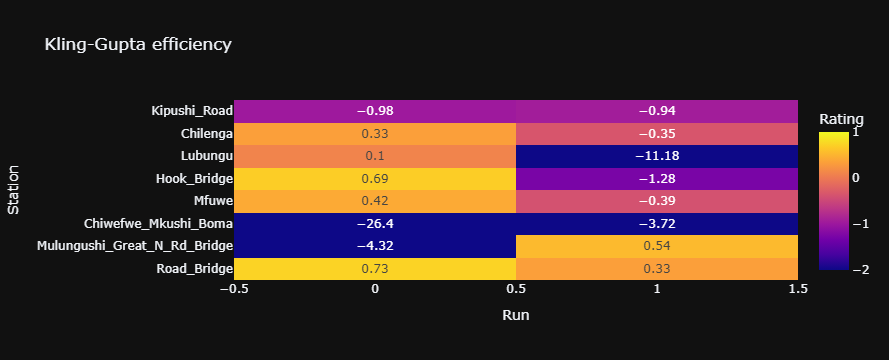

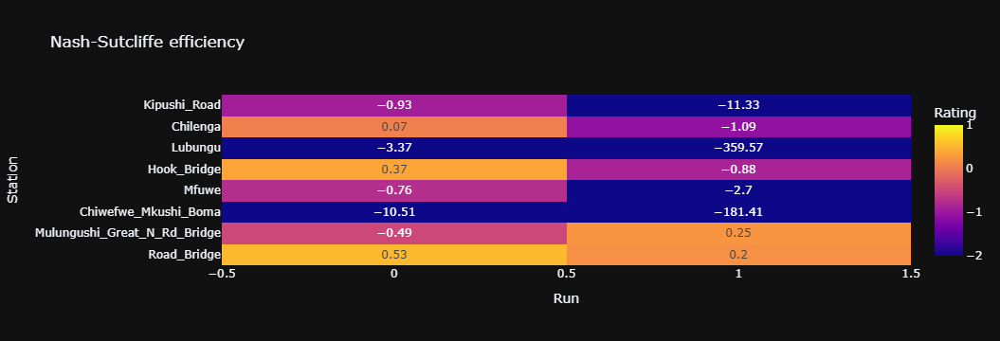

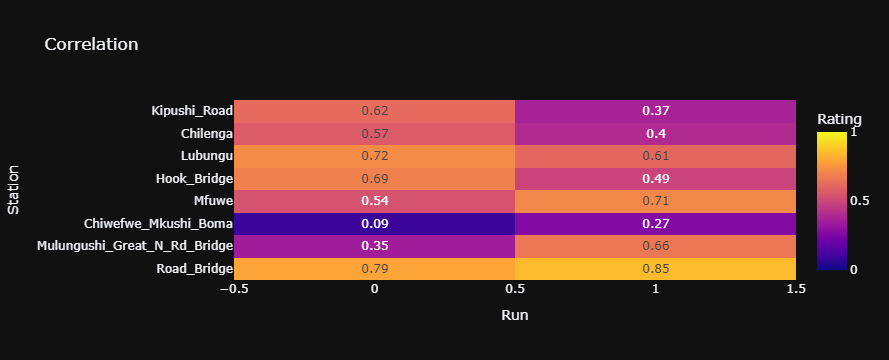

In [9]:
import plotly.express as px

z= [stn for stn in KGE_allStn]
fig = px.imshow(z, template=template, text_auto=True, zmin = -2, zmax = 1.0, title='Kling-Gupta efficiency',
                labels=dict(y="Station", x='Run', color="Rating"),
                x=[i for i in range(len(Simulation_output_folders)+len(Simulated_stations_Excel_folders))],
                y=[str(i[0]) for i in Stations_namesLocations])

fig.show()


z= [stn for stn in NS_allStn]
fig = px.imshow(z, template=template, text_auto=True, zmin = -2, zmax = 1.0, title='Nash-Sutcliffe efficiency',
                labels=dict(y="Station", x='Run', color="Rating"),
                x=[i for i in range(len(Simulation_output_folders)+len(Simulated_stations_Excel_folders))],
                y=[str(i[0]) for i in Stations_namesLocations])
fig.show()

z= [stn for stn in corr_allStn]
fig = px.imshow(z, template=template, text_auto=True, zmin = 0, zmax = 1.0, title='Correlation',
                labels=dict(y="Station", x='Run', color="Rating"),
                x=[i for i in range(len(Simulation_output_folders)+len(Simulated_stations_Excel_folders))],
                y=[str(i[0]) for i in Stations_namesLocations])
fig.show()